<a href="https://colab.research.google.com/github/Prashanth4333/Banking-/blob/main/gemini_api_python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [101]:
!pip install -q -U google-generativeai

# Import Modules

In [103]:
import google.generativeai as genai
import pathlib
import textwrap
from IPython.display import Markdown, display

# Demo Example

In [11]:
def to_markdown(text):
  text = text.replace('@',' *')
  return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))



In [12]:
input_text = "This ia the @ sample text with at the rate."
result = to_markdown(input_text)

display(result)

> This ia the  * sample text with at the rate.

# Adding Gemini API Key from Colab Secret

In [13]:
from google.colab import userdata

In [14]:
GOOGLE_API_KEY=userdata.get('GOOGLE_API_KEY')

In [15]:
genai.configure(
    api_key=GOOGLE_API_KEY
)

# Checking For List of MOdels

In [18]:
for models in genai.list_models():
  print(models)

Model(name='models/embedding-gecko-001',
      base_model_id='',
      version='001',
      display_name='Embedding Gecko',
      description='Obtain a distributed representation of a text.',
      input_token_limit=1024,
      output_token_limit=1,
      supported_generation_methods=['embedText', 'countTextTokens'],
      temperature=None,
      max_temperature=None,
      top_p=None,
      top_k=None)
Model(name='models/gemini-1.5-pro-latest',
      base_model_id='',
      version='001',
      display_name='Gemini 1.5 Pro Latest',
      description=('Alias that points to the most recent production (non-experimental) release '
                   'of Gemini 1.5 Pro, our mid-size multimodal model that supports up to 2 '
                   'million tokens.'),
      input_token_limit=2000000,
      output_token_limit=8192,
      supported_generation_methods=['generateContent', 'countTokens'],
      temperature=1.0,
      max_temperature=2.0,
      top_p=0.95,
      top_k=40)
Model(name='m

# Finding the which only supports for Text Generation

In [19]:
for models in genai.list_models():
  if 'generateContent' in models.supported_generation_methods:
    print(models.name)

models/gemini-1.5-pro-latest
models/gemini-1.5-pro-002
models/gemini-1.5-pro
models/gemini-1.5-flash-latest
models/gemini-1.5-flash
models/gemini-1.5-flash-002
models/gemini-1.5-flash-8b
models/gemini-1.5-flash-8b-001
models/gemini-1.5-flash-8b-latest
models/gemini-2.5-pro-preview-03-25
models/gemini-2.5-flash-preview-05-20
models/gemini-2.5-flash
models/gemini-2.5-flash-lite-preview-06-17
models/gemini-2.5-pro-preview-05-06
models/gemini-2.5-pro-preview-06-05
models/gemini-2.5-pro
models/gemini-2.0-flash-exp
models/gemini-2.0-flash
models/gemini-2.0-flash-001
models/gemini-2.0-flash-exp-image-generation
models/gemini-2.0-flash-lite-001
models/gemini-2.0-flash-lite
models/gemini-2.0-flash-preview-image-generation
models/gemini-2.0-flash-lite-preview-02-05
models/gemini-2.0-flash-lite-preview
models/gemini-2.0-pro-exp
models/gemini-2.0-pro-exp-02-05
models/gemini-exp-1206
models/gemini-2.0-flash-thinking-exp-01-21
models/gemini-2.0-flash-thinking-exp
models/gemini-2.0-flash-thinking-exp

# Model Selected and Loaded ( gemini-2.5-pro )

In [20]:
model = genai.GenerativeModel('gemini-2.5-pro')

# Generating Text to Text Generation
Giving Promt to the Model

In [23]:
%%time
response = model.generate_content('Explain about Casio MVD 106')

CPU times: user 206 ms, sys: 34.1 ms, total: 240 ms
Wall time: 35.2 s


Getting Response

In [25]:
to_markdown(response.text)

> Of course! You're likely referring to the **Casio MDV-106**, one of the most famous and highly-regarded budget watches in the world. It's a common typo to see it as "MVD," but the official model is MDV-106.
> 
> This watch has a legendary status among watch enthusiasts for offering incredible value for money. It's affectionately known by its nickname: the **"Casio Duro,"** which means "hard" or "durable" in Spanish.
> 
> Here’s a detailed breakdown of the Casio MDV-106 "Duro."
> 
> ---
> 
> ### 1. The Big Picture: What is the Casio Duro?
> 
> The Casio MDV-106 is a **classic, analog, diver-style quartz watch**. It's designed to look and function like a traditional dive watch (like a Rolex Submariner or Omega Seamaster) but at a tiny fraction of the price, typically selling for between **$40 and $70**.
> 
> It has gained fame for being arguably the best "bang-for-your-buck" watch you can buy. It's so well-regarded that even billionaire Bill Gates has been frequently photographed wearing one.
> 
> ### 2. Key Features and Specifications
> 
> This is where the Duro really shines, as its specs are far better than its price suggests.
> 
> *   **Design:** A timeless and clean dive watch aesthetic. It's simple, legible, and incredibly versatile.
> *   **Case:** A solid **stainless steel** case with a diameter of **44mm**. This is a relatively large watch, but its classic design helps it wear well.
> *   **Water Resistance:** An impressive **200 meters (660 feet)**. This is not just "splash-proof"; it's genuine water resistance suitable for swimming, snorkeling, and recreational scuba diving. This is its standout feature at this price point.
> *   **Bezel:** A **120-click unidirectional rotating bezel**. This is a functional tool for timing. On a dive watch, it's designed to only rotate counter-clockwise so that a diver can't accidentally knock it and *increase* their perceived time underwater. The clicking action is surprisingly crisp for a budget watch.
> *   **Crystal:** A flat **mineral glass** crystal. It's reasonably scratch-resistant for daily use, though not as tough as the more expensive sapphire crystal found on luxury watches.
> *   **Movement:** A reliable and accurate **Japanese quartz movement**. It's powered by a battery that lasts for about 3 years. This means you just set it and forget it—no daily winding required.
> *   **Dial:** The dial is clear and highly legible, with large, applied indices (hour markers) and a simple date window at the 3 o'clock position. The hands and markers are coated with a luminous material for low-light visibility.
> *   **Strap:** It comes standard on a 22mm black **resin (rubber) strap**. This is functional and waterproof but is often considered the watch's weakest point, as many users find it a bit stiff.
> 
> 
> 
> 
> ### 3. The Famous Marlin Logo
> 
> For many years, the defining feature of the Duro was the small **marlin fish logo** on the dial and engraved on the case back. This logo signified that the watch had a water resistance of at least 200 meters.
> 
> **Important Note:** Around 2020-2021, Casio began phasing out the marlin logo due to licensing changes. Newer models, often designated as the **MDV-107**, are virtually identical to the MDV-106 but **do not have the marlin logo**. For collectors and enthusiasts, the "Marlin" versions are now more sought-after.
> 
> ### 4. Why is it So Popular?
> 
> 1.  **Unbeatable Value:** You get a 200m water-resistant, stainless steel, reliable, and handsome watch from a respected brand for the price of a nice dinner. There is almost no competition in this price range.
> 2.  **Durability and Reliability:** It’s a workhorse. The solid case and quartz movement make it a tough "beater" watch that you don't have to worry about.
> 3.  **Versatility (The "Strap Monster"):** While the stock strap is just okay, the watch's classic design makes it look fantastic on a huge variety of other straps. Owners love to customize it with:
>     *   **NATO straps:** For a casual, military-inspired look.
>     *   **Stainless steel bracelets:** To give it a more premium, "expensive" feel.
>     *   **Leather straps:** For a more formal or office-appropriate style.
> 4.  **The "Bill Gates" Effect:** The fact that one of the world's wealthiest people chooses to wear this affordable watch speaks volumes about its practicality and unpretentious appeal.
> 5.  **A Gateway to Watch Collecting:** For many people, the Casio Duro is their first "real" watch. It introduces them to concepts like dive bezels, water resistance, and strap changing without a significant financial investment.
> 
> ### 5. Things to Consider (The Downsides)
> 
> *   **Size:** At 44mm, it can be too large for people with smaller wrists.
> *   **The Stock Strap:** As mentioned, many people replace the resin strap almost immediately for better comfort and style.
> *   **Lume:** The luminescence (the glow on the hands and markers) is functional but not very bright or long-lasting compared to more expensive dive watches like those from Seiko or Citizen.
> *   **Mineral Crystal:** It can get scratched more easily than a sapphire crystal.
> 
> ### Conclusion
> 
> The **Casio MDV-106 "Duro"** is a true icon in the world of affordable watches. It offers a set of features, durability, and a classic design that are simply unmatched at its price. Whether you need a tough, reliable watch for daily wear, a vacation watch for the beach, or you're just starting a collection, the Casio Duro is one of the best and safest purchases you can make.

"CANDIDATES" - Means is shows multiple answers from that it select the Best Response

In [35]:
response.candidates

[content {
  role: "model"
}
finish_reason: STOP
index: 0
]

In [30]:
response.prompt_feedback

In [36]:
response.parts

[]

In [37]:
%%time
response = model.generate_content('Explain about Casio MVD 106', stream=True)
for chunk in response:
  print(chunk.text)
  print("-"*40)

Of course! You're likely referring to the **Cas
----------------------------------------
io MDV-106**, a watch that has achieved legendary status in the world of affordable timepieces. It'
----------------------------------------
s more commonly known by its nickname: the **"Casio Duro."**

Here's a comprehensive explanation of what makes
----------------------------------------
 the Casio Duro MDV-106 so special.

---

### Overview: The King of Budget Dive Watches

The
----------------------------------------
 Casio MDV-106 "Duro" is a quartz-powered, analog dive-style watch. Its
----------------------------------------
 reputation is built on a simple premise: it offers an incredible set of features, durability, and classic design for an astonishing
----------------------------------------
ly low price (typically between $50 and $70).

For many, it's the undisputed "best value for
----------------------------------------
 money" watch you can buy. It punches far above its weight clas

# Generating Image to Text Generation

Image is loaded and named it as '*image.jpg*'.

---

**NOTE** - After selecting image from net direct copy the image address without opening the image in a new TAB

In [104]:
!curl -o image.jpg  https://images.pexels.com/photos/417074/pexels-photo-417074.jpeg?cs=srgb&dl=pexels-souvenirpixels-417074.jpg&fm=jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1245k  100 1245k    0     0  9566k      0 --:--:-- --:--:-- --:--:-- 9583k


To Load the image

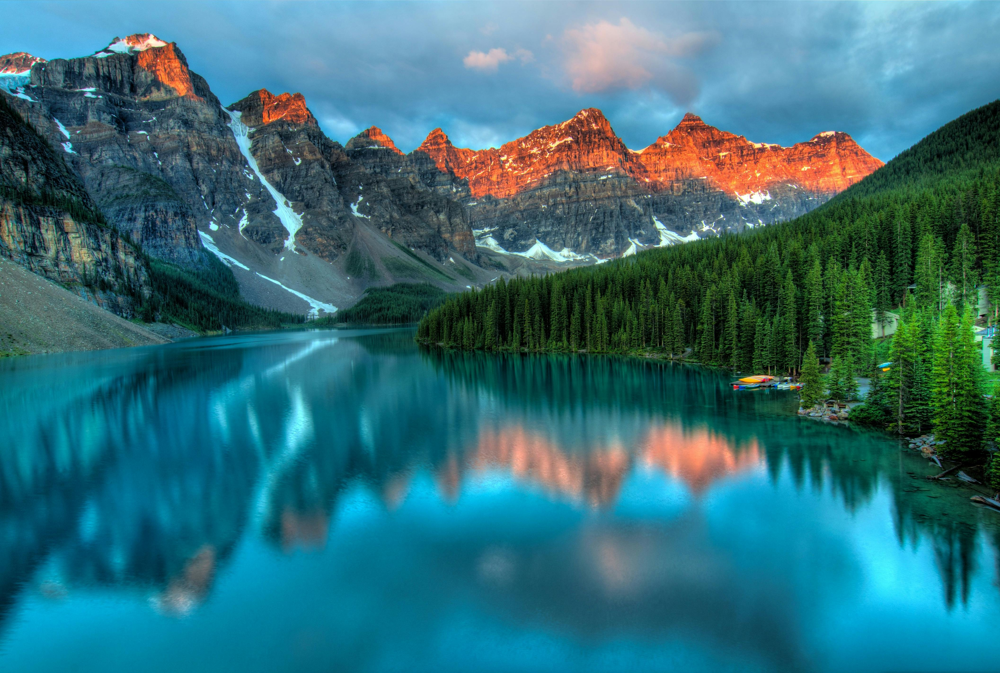

In [105]:
import PIL.Image
img = PIL.Image.open('image.jpg')
img


MODEL Loaded

In [115]:
model2 = genai.GenerativeModel('gemini-1.5-flash-latest')

In [116]:
response = model2.generate_content(img)

Generating Output text from image

In [119]:
to_markdown(response.text)

> That's a beautiful image of Moraine Lake in Banff National Park, Alberta, Canada.  The photo captures the iconic turquoise water, the surrounding Ten Peaks, and the reflection of the mountains in the still water, all bathed in the golden light of sunrise or sunset.


In [118]:
# import PIL.Image
# import google.generativeai as genai

# # Load the image
# img = PIL.Image.open('image.jpg')

# # Initialize the model
# # Using the correct model name that supports generateContent for images
# # model2 = genai.GenerativeModel('gemini-1.5-flash-latest')
# model2 = genai.GenerativeModel('gemini-2.0-flash-preview-image-generation')

# # Generate content from the image
# response = model2.generate_content(img)

# # Display the response (you might need to adjust this based on the response format)
# print(response.text)